In [55]:
import cv2
import numpy as np
from scipy.signal import correlate2d
import matplotlib.pyplot as plt
import time

In [61]:
def frobenius_norm(frame):
    return np.sqrt(np.sum(frame ** 2))

def normalized_cross_correlation(F1, F2):
    F1 = (F1 - np.mean(F1)) / (np.std(F1) + 1e-5)
    F2 = (F2 - np.mean(F2)) / (np.std(F2) + 1e-5)
    corr = correlate2d(F1, F2, mode='full')
    return np.max(corr) / (F1.size)

def diff(F1, F2):
    return 1 - normalized_cross_correlation(F1, F2)

def select_key_frames(frames, threshold=0.2):
    selected_indices = [0]
    last_selected = frames[0]

    for i in range(1, len(frames)):
        d = diff(last_selected, frames[i])
        if d > threshold:
            selected_indices.append(i)
            last_selected = frames[i]

    return selected_indices

def load_video_frames(video_path, max_frames=None, resize_to=(128, 128)):
    cap = cv2.VideoCapture(video_path)
    frames = []
    count = 0

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if resize_to:
            gray = cv2.resize(gray, resize_to)

        frames.append(gray)

        count += 1
        if max_frames and count >= max_frames:
            break

    cap.release()
    return frames

In [65]:
start_time = time.time()
video_path = "WIN_20250519_14_04_55_Pro.mp4"
frames = load_video_frames(video_path, max_frames=400)

selected_indices = select_key_frames(frames, threshold=0.01)

print(f"Selected key frame indices: {selected_indices}")

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Execution time: {elapsed_time:.4f} seconds")

Selected key frame indices: [0, 67, 103, 189, 192, 194, 196, 197, 198, 199, 200, 201, 202, 203, 204, 206, 208, 212, 216, 221, 235, 244, 253, 263, 276, 279, 281, 283, 285, 287, 289, 291, 293, 295, 297, 299, 301, 304, 307, 310, 316, 320, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 361, 362, 363, 364, 365, 366, 367, 368, 372, 377, 381]
Execution time: 398.0370 seconds


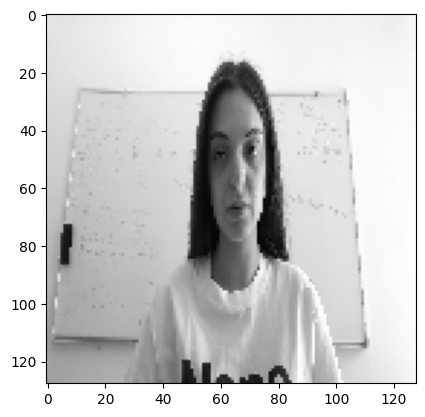

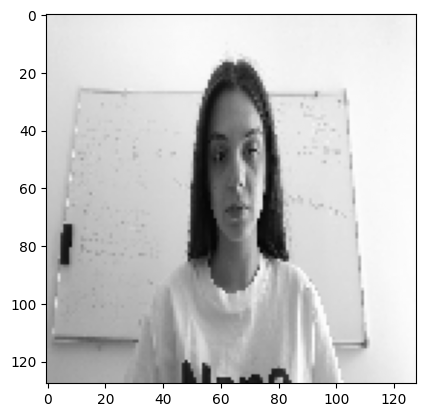

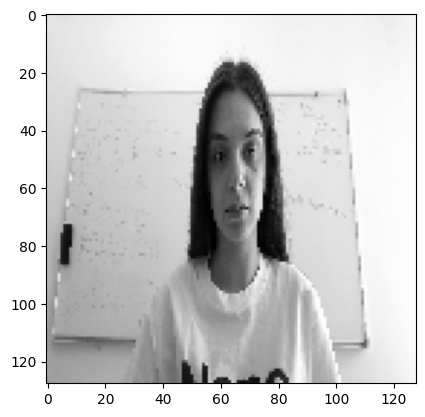

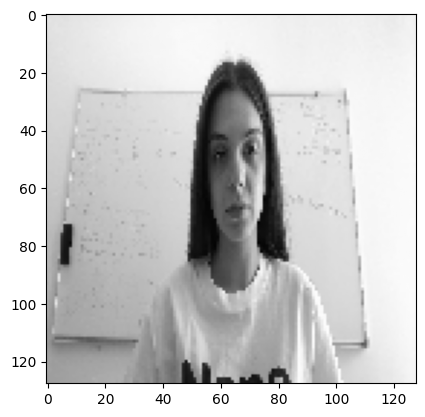

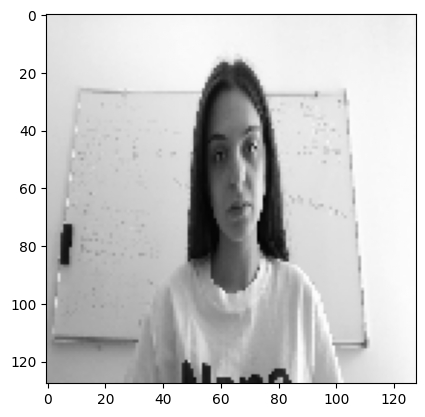

...

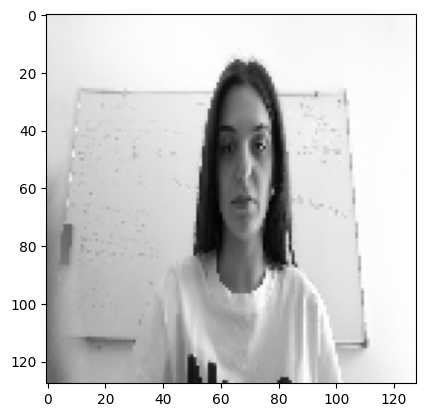

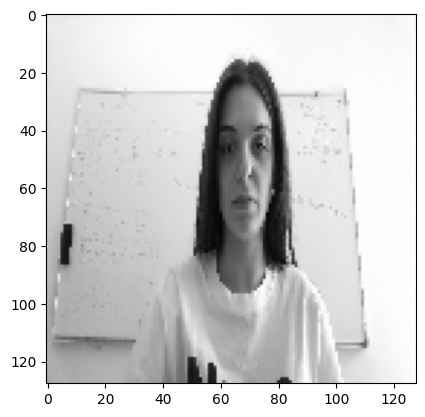

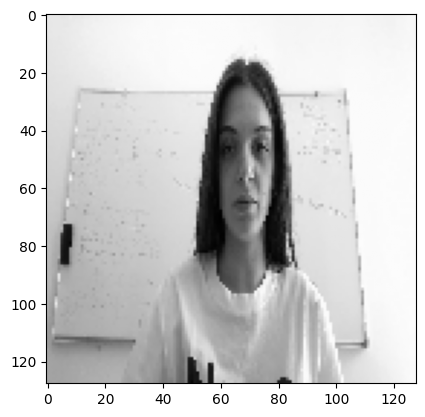

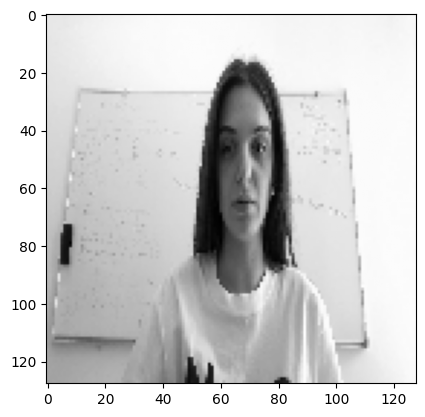

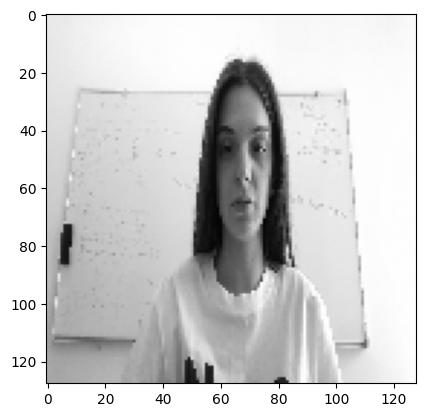

In [71]:
for ind in selected_indices:
    plt.figure()
    plt.imshow(frames[ind], cmap = 'gray')
    plt.show()

I am trying similar thing after encoding with openai/clip-vit-large-patch14 and using cosine similarity between vectors. 

In [9]:
import clip
print(clip.__file__) 

C:\Users\marij\anaconda3\Lib\site-packages\clip\__init__.py


In [2]:
import torch
import clip
from PIL import Image
import cv2
import numpy as np
import time
import matplotlib.pyplot as plt

In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"

model, preprocess = clip.load("ViT-B/32", device=device)

In [6]:
def load_video_frames_clip(video_path, max_frames=200, step=1):
    cap = cv2.VideoCapture(video_path)
    frames = []
    count = 0
    while cap.isOpened() and count < max_frames:
        ret, frame = cap.read()
        if not ret:
            break
        if count % step == 0:
            image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            pil_img = Image.fromarray(image)
            frames.append(preprocess(pil_img))
        count += 1
    cap.release()
    return torch.stack(frames).to(device)

def get_clip_features(frames_tensor):
    with torch.no_grad():
        return model.encode_image(frames_tensor).float()

def cosine_dissimilarity(v1, v2):
    return 1 - torch.nn.functional.cosine_similarity(v1, v2, dim=0)

def select_clip_keyframes(clip_vectors, threshold=0.01):
    selected_indices = [0]
    last_vec = clip_vectors[0]

    for i in range(1, len(clip_vectors)):
        d = cosine_dissimilarity(last_vec, clip_vectors[i])
        if d.item() > threshold:
            selected_indices.append(i)
            last_vec = clip_vectors[i]

    return selected_indices

In [8]:
start_time = time.time()
video_path = "WIN_20250519_14_04_55_Pro.mp4"
frames_tensor = load_video_frames_clip(video_path, max_frames=400, step=1)
clip_features = get_clip_features(frames_tensor)

selected_indices = select_clip_keyframes(clip_features, threshold=0.01)
print("Selected frame indices:", selected_indices)
end_time = time.time()
elapsed_time = end_time - start_time

print(f"Execution time: {elapsed_time:.4f} seconds")

Selected frame indices: [0, 5, 25, 31, 69, 77, 99, 117, 121, 159, 181, 193, 197, 199, 201, 205, 209, 237, 267, 278, 283, 286, 288, 291, 294, 297, 304, 312, 321, 324, 326, 327, 328, 329, 330, 331, 332, 333, 334, 336, 337, 338, 339, 340, 341, 345, 346, 347, 348, 349, 350, 352, 353, 354, 356, 357, 359, 361, 362, 363, 364, 369, 375, 381]
Execution time: 17.7250 seconds


In [10]:
def denormalize_clip_image(tensor):
    mean = torch.tensor([0.4815, 0.4578, 0.4082]).to(tensor.device).view(3, 1, 1)
    std = torch.tensor([0.2686, 0.2613, 0.2758]).to(tensor.device).view(3, 1, 1)
    return (tensor * std + mean).clamp(0, 1)

torch.Size([391, 512])
torch.Size([391, 3, 224, 224])


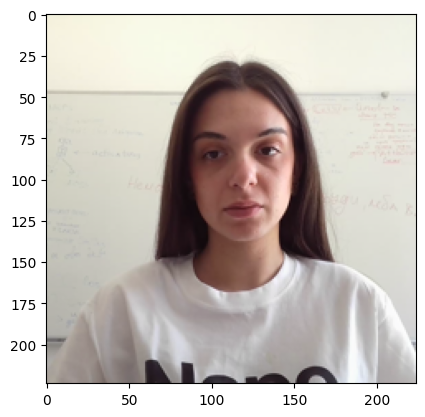

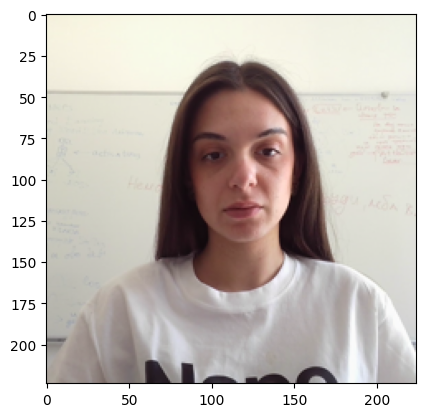

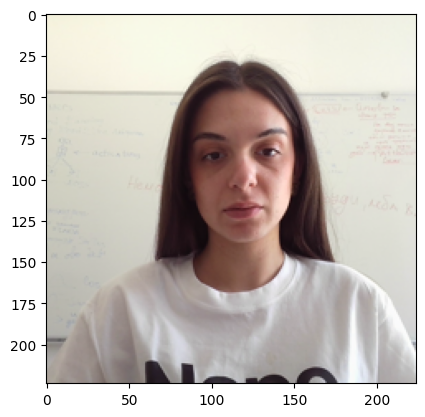

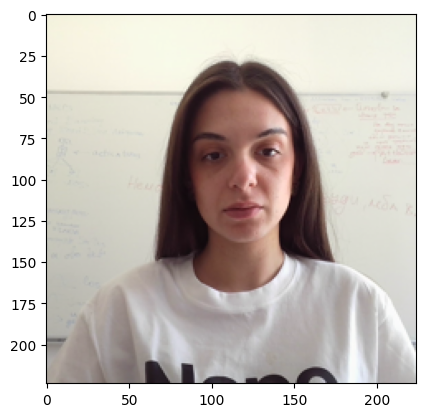

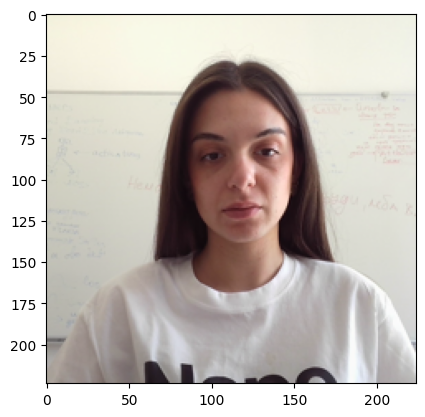

...

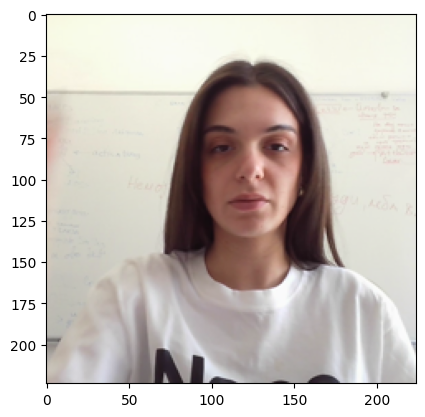

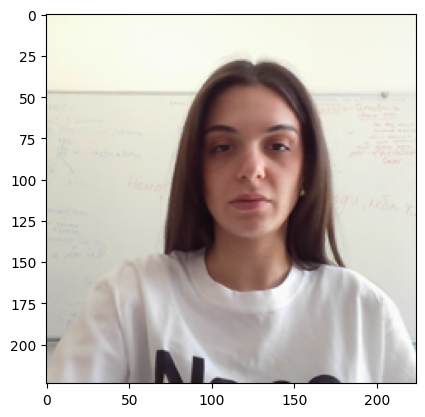

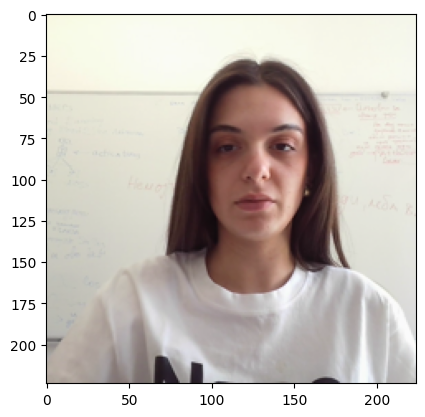

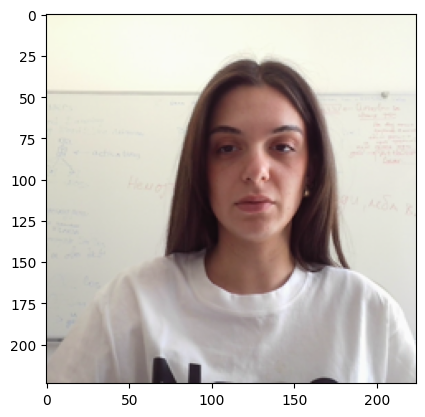

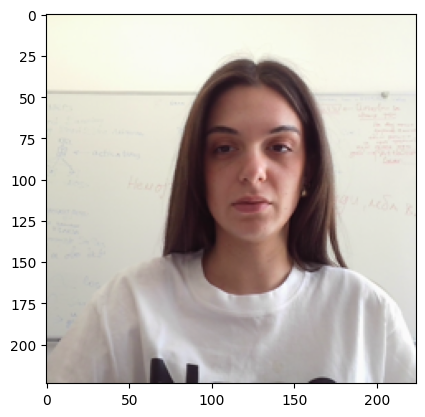

In [12]:
print(clip_features.shape)
print(frames_tensor.shape)
for frame in frames_tensor[selected_indices]:
    img_tensor = denormalize_clip_image(frame.cpu())
    img_np = img_tensor.permute(1, 2, 0).numpy()
    plt.figure()
    plt.imshow(img_np)
    plt.show()